In [1]:
import os
import argparse
import time
from contextlib import contextmanager
from matplotlib import pyplot as plt
import pandas as pd
import seaborn as sns
import numpy as np
import json
import torch
import torchvision
import sys
sys.path.append("../")
from methods_v2 import NMF_CONCEPTS, NMF_CONCEPTS_VIZ, NMF_CONCEPTS_VIZ_2
from data_preprocessing import get_train_dataset_cifar10, get_test_dataset_cifar10, get_train_dataset_cifar100, get_test_dataset_cifar100, get_train_dataset_ImageNet_1K, get_test_dataset_ImageNet_1K
from models import load_pretrained_weights_32


# # device
device = torch.device("cuda:0")
print("Using device:", device)


# models
def load_model(experiment="cifar10", load_mlp=False):
    
    # model trained on CIFAR10
    if experiment == "cifar10":
        model = load_pretrained_weights_32()

    # model trained on CIFAR10
    elif experiment == "cifar100":
        model = load_pretrained_weights_32(dataset='CIFAR-100', model_version='s0', num_classes=100)
    
    # model trained on ImageNet
    elif experiment == "imagenet":
        weights = torchvision.models.ResNet50_Weights.IMAGENET1K_V1
        model = torchvision.models.resnet50(weights=weights).to(device)

    else:
        raise ValueError("`experiment` should be 'cifar10' or 'cifar100'.")
    
    model.to(device)
    model.eval()
    return model


# datasets
def load_datasets(experiment: str = "cifar100"):

    # CIFAR10 
    if experiment == "cifar10":
        # 1a- load in-distribution dataset: CIFAR-10
        ds_fit = get_train_dataset_cifar10()
        ds_in = get_test_dataset_cifar10()
        # ds_out_dict = {
        #     "cifar100": get_test_dataset_cifar100(),
        #     "svhn" : get_test_dataset_svhn(),
        #     "places365" : get_test_dataset_places365(),
        #     "texture" : get_test_dataset_texture(),
        #     "Tin": get_test_dataset_Tiny(),
        # }

     # CIFAR100
    elif experiment == "cifar100":
        # 1a- load in-distribution dataset: CIFAR-10
        ds_fit = get_train_dataset_cifar100()
        ds_in = get_test_dataset_cifar100()
        # ds_out_dict = {
        #     "cifar10": get_test_dataset_cifar10(),
        #     "svhn" : get_test_dataset_svhn(),
        #     "places365" : get_test_dataset_places365(),
        #     "texture" : get_test_dataset_texture(),
        #     "Tin": get_test_dataset_Tiny(),
        # }

    elif experiment == "imagenet":
        # 1a- load in-distribution dataset: CIFAR-10
        ds_fit = get_train_dataset_ImageNet_1K()
        ds_in = None  # get_test_dataset_ImageNet_1K()
        # ds_out_dict = {
        #     # "inaturalist": get_test_dataset_inaturalist(),
        #     # "ninco" : get_test_dataset_NINCO(),
        #     "ssb_hard" : get_test_dataset_SSB_hard(),
        #     "texture" : get_test_dataset_texture(),
        #     # "places365": get_test_dataset_places365(),
        # }
    

    else:
        raise ValueError("`experiment` should be or 'cifar10' or cifar100")

    print("moving data to : ", device)
    for x, y in ds_fit:
        x.to(device)
        y.to(device)

    # for x, y in ds_in:
    #     x.to(device)
    #     y.to(device)

    # for name, ds_out in ds_out_dict.items():
    #     for x, y in ds_out:
    #         x.to(device)
    #         y.to(device)
       
    return ds_fit, ds_in # ds_out_dict



2024-07-29 16:48:28.612721: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-07-29 16:48:29.749346: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


Using device: cuda:0


In [2]:
ds_fit, ds_in = load_datasets("imagenet")

model = load_model("imagenet")

detector = NMF_CONCEPTS_VIZ(model=model)




the length of the ImageNet_1K Training dataset :  3000
moving data to :  cuda:0


Class 3 has 14700 images with shape torch.Size([3, 224, 224])
Class 4 has 14700 images with shape torch.Size([3, 224, 224])
Class 5 has 14700 images with shape torch.Size([3, 224, 224])
Class 6 has 14700 images with shape torch.Size([3, 224, 224])
Class 7 has 14700 images with shape torch.Size([3, 224, 224])
Class 8 has 14700 images with shape torch.Size([3, 224, 224])
Class 9 has 14700 images with shape torch.Size([3, 224, 224])
the shape of the features :  (14700, 2048)
calculating NMF ...................................
shape of U :  (14700, 5)
shape of V :  (5, 2048)


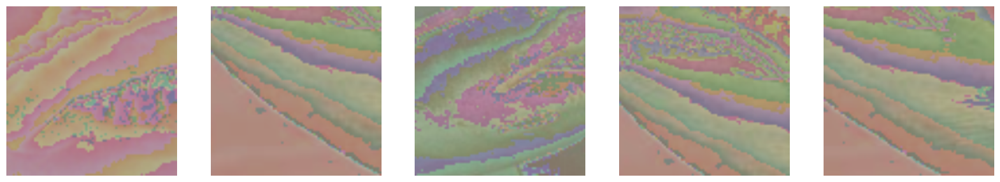

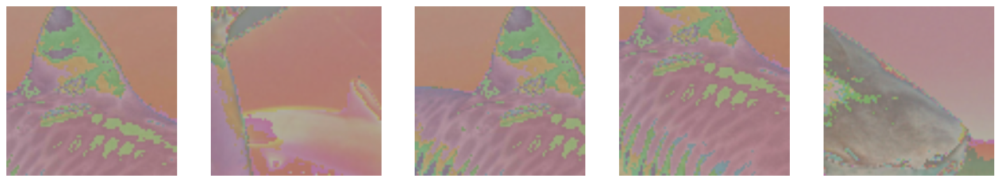

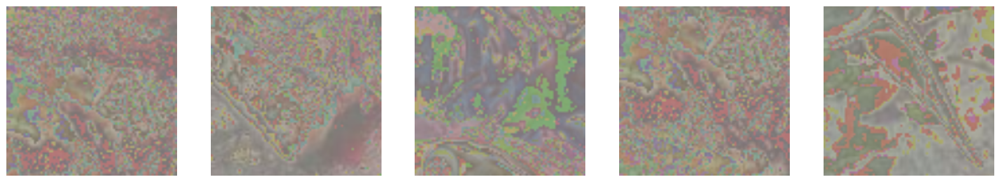

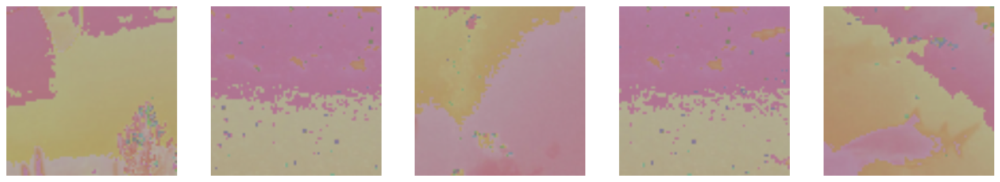

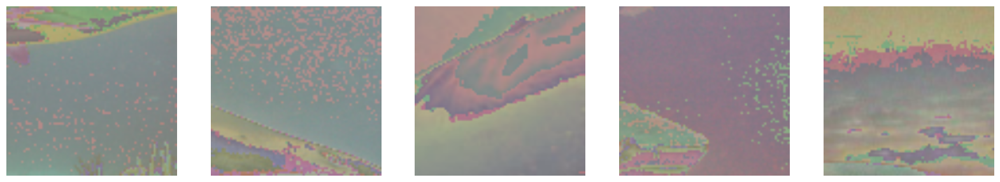

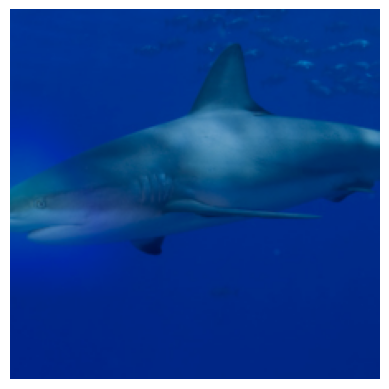

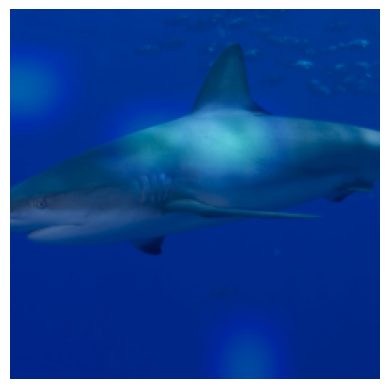

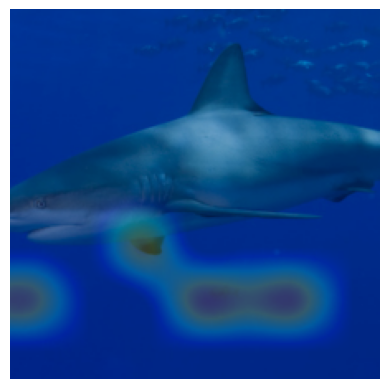

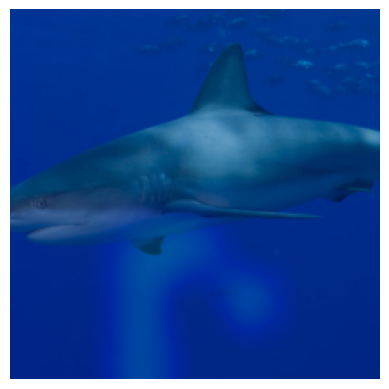

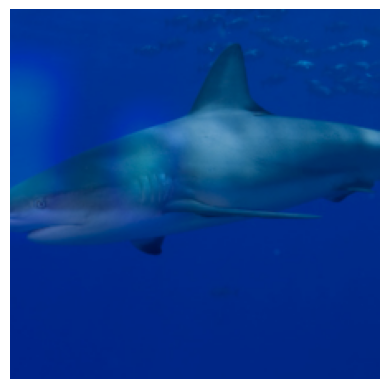

the shape of the features :  (14700, 2048)
calculating NMF ...................................
shape of U :  (14700, 5)
shape of V :  (5, 2048)


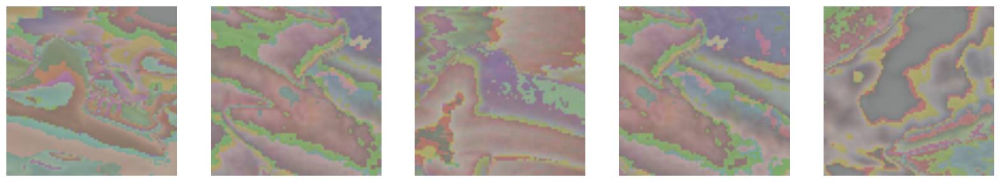

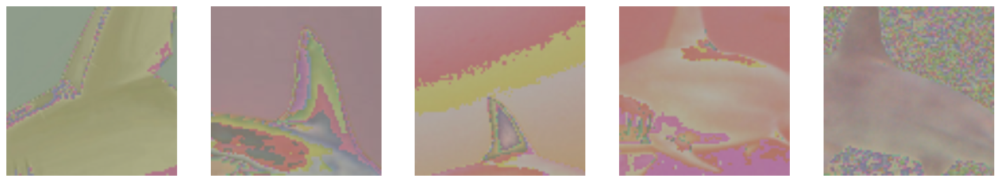

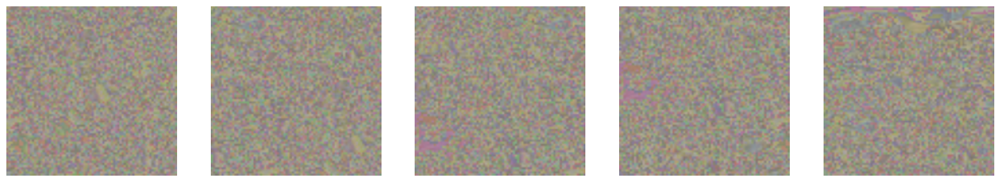

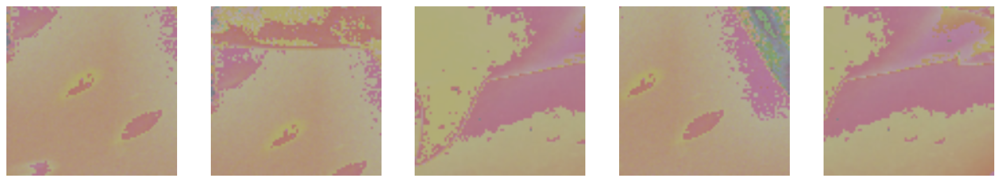

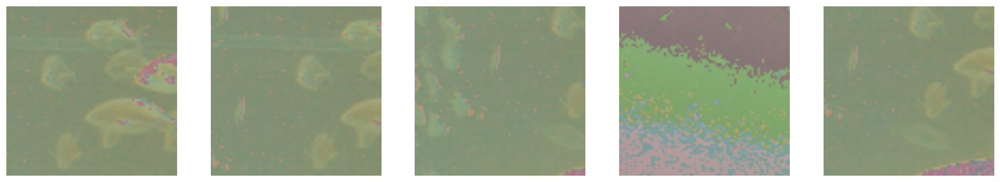

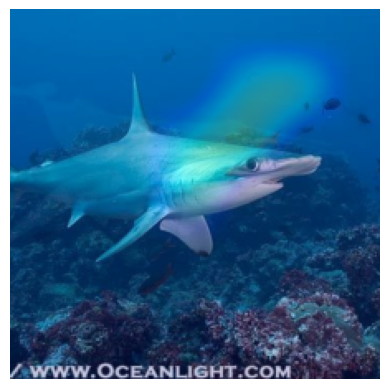

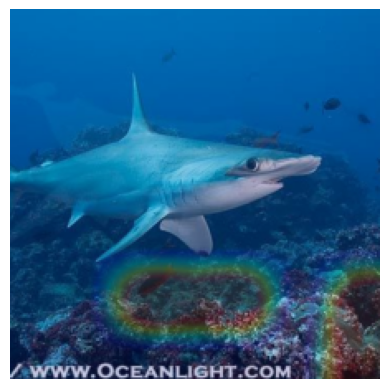

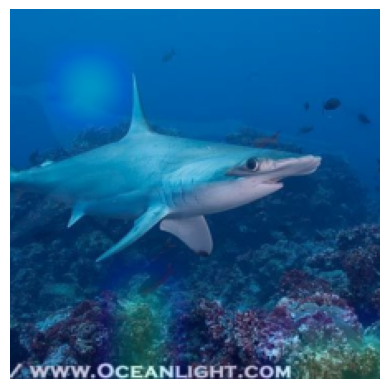

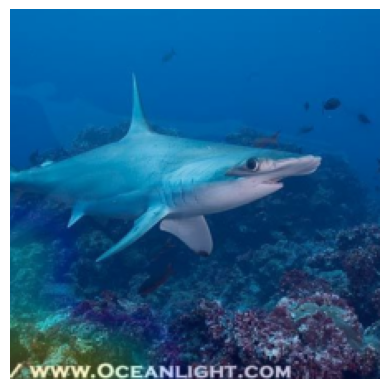

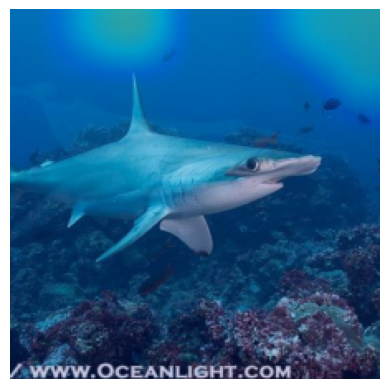

the shape of the features :  (14700, 2048)
calculating NMF ...................................
shape of U :  (14700, 5)
shape of V :  (5, 2048)


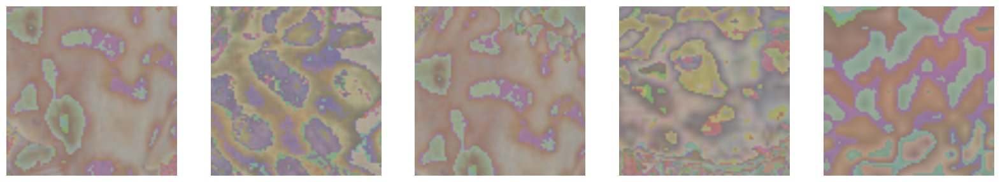

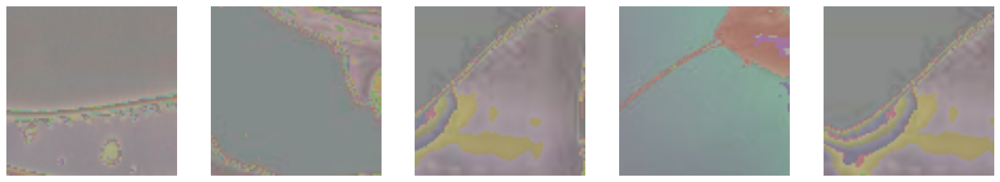

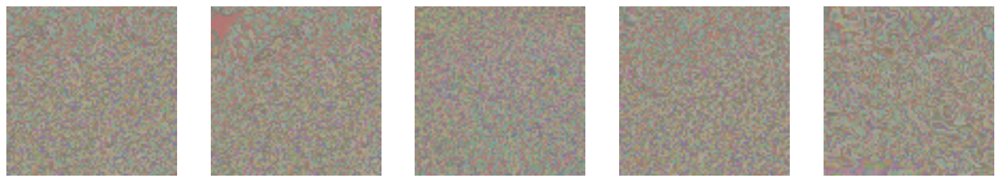

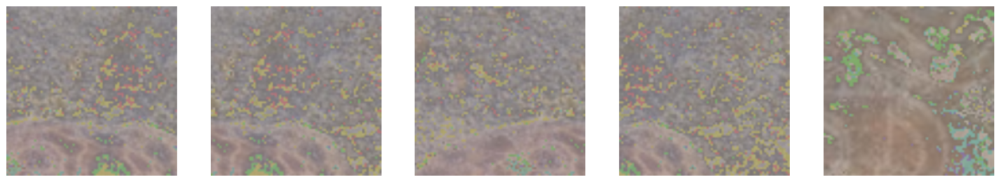

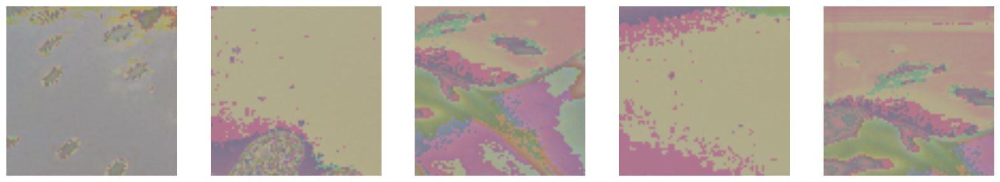

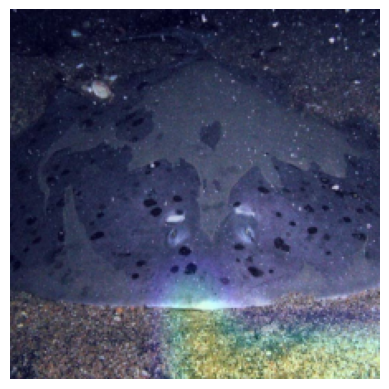

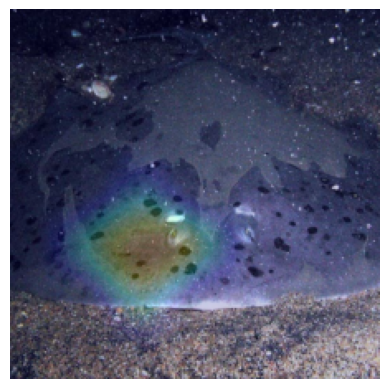

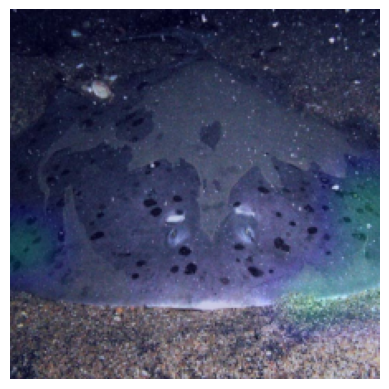

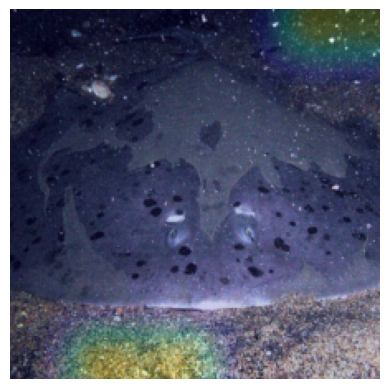

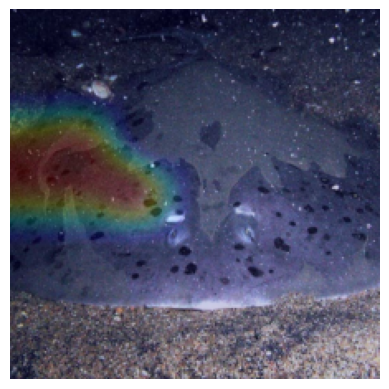

the shape of the features :  (14700, 2048)
calculating NMF ...................................
shape of U :  (14700, 5)
shape of V :  (5, 2048)


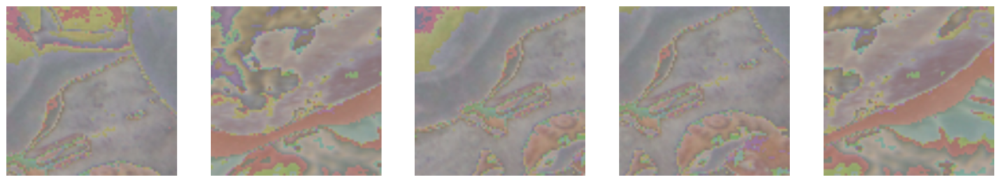

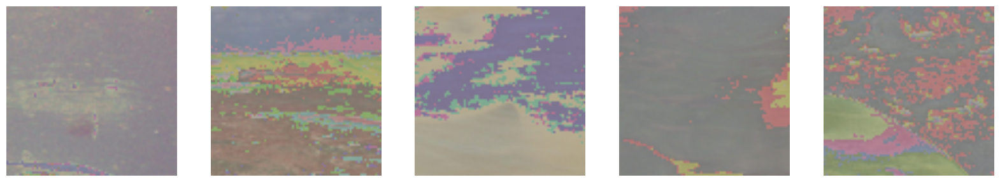

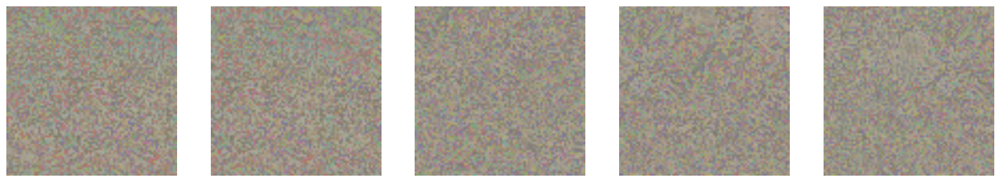

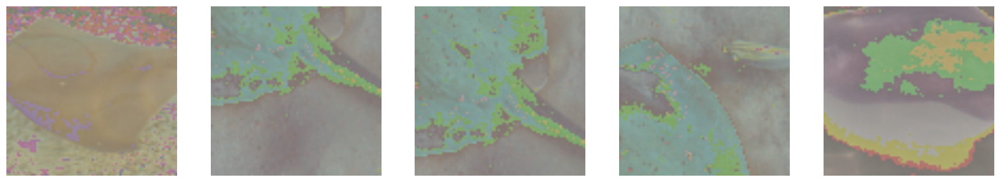

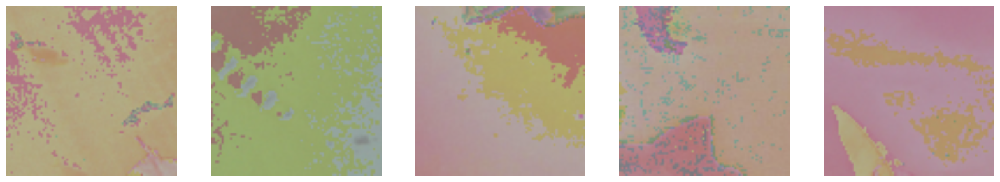

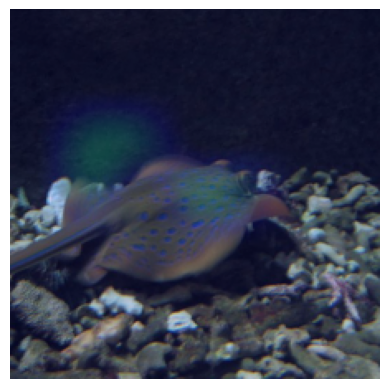

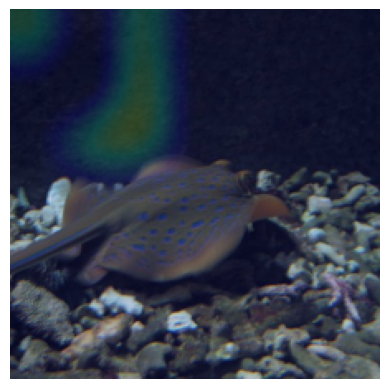

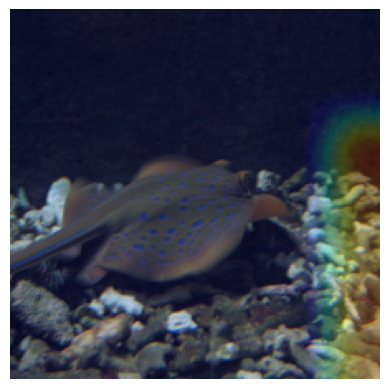

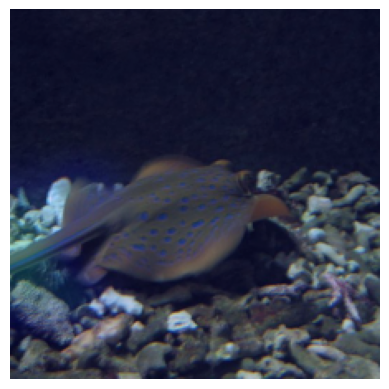

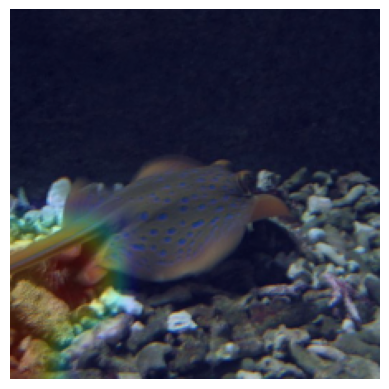

the shape of the features :  (14700, 2048)
calculating NMF ...................................
shape of U :  (14700, 5)
shape of V :  (5, 2048)


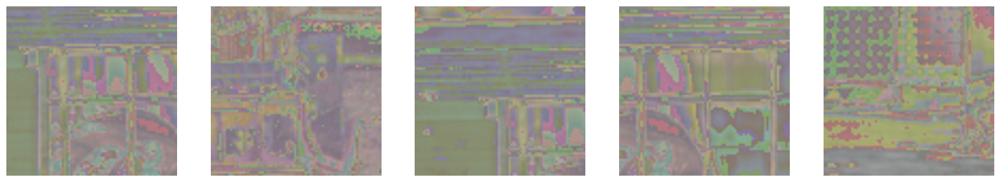

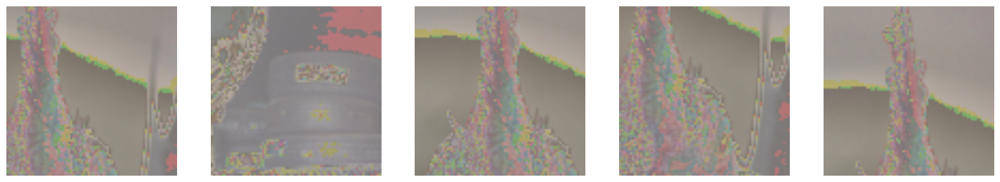

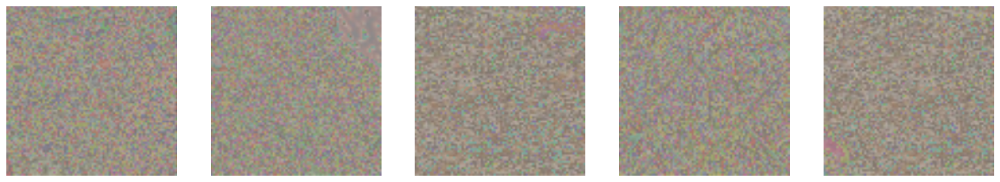

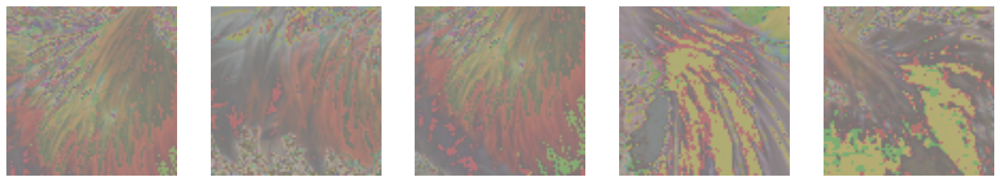

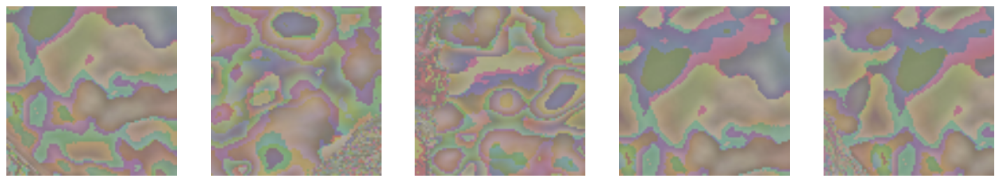

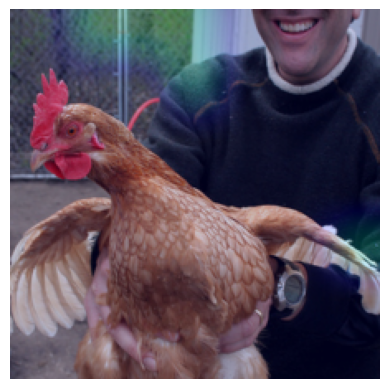

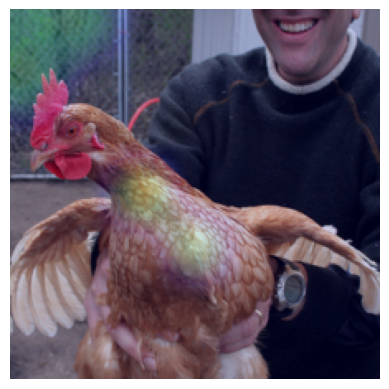

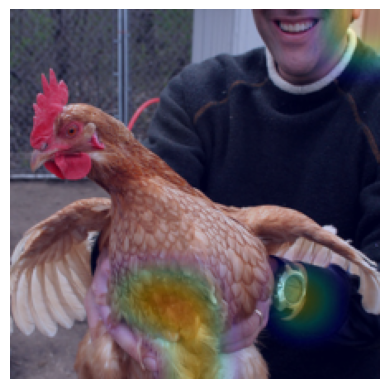

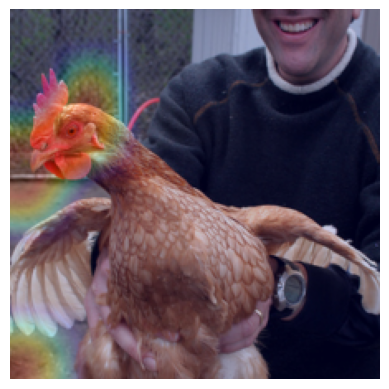

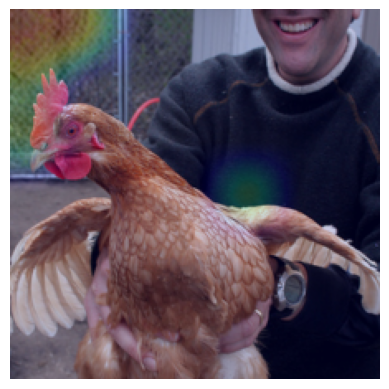

the shape of the features :  (14700, 2048)
calculating NMF ...................................
shape of U :  (14700, 5)
shape of V :  (5, 2048)


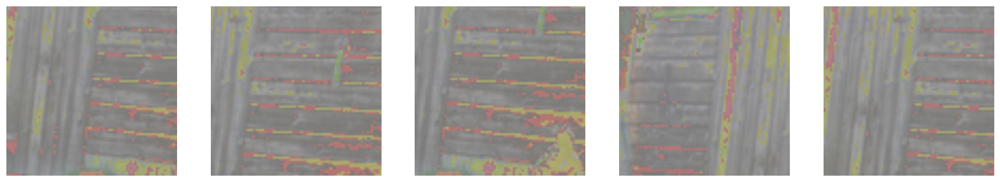

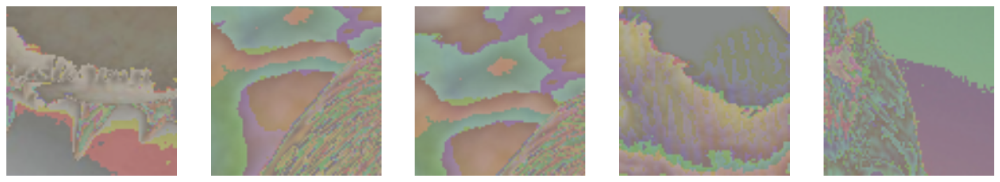

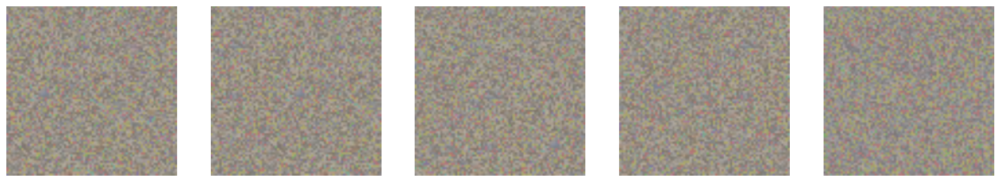

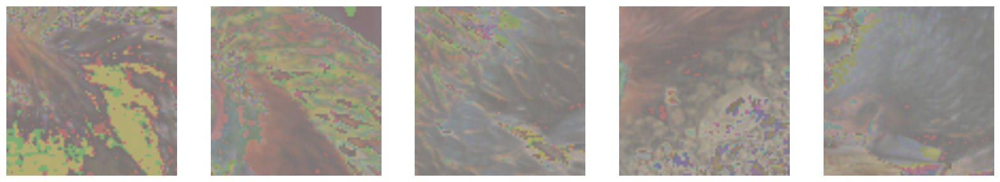

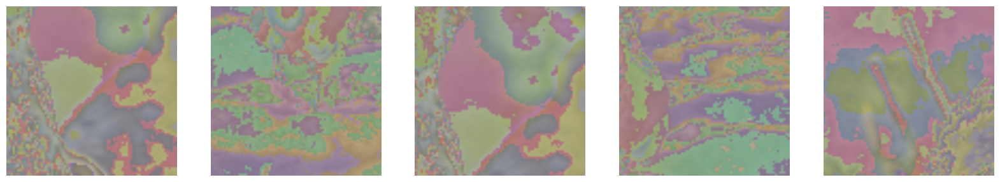

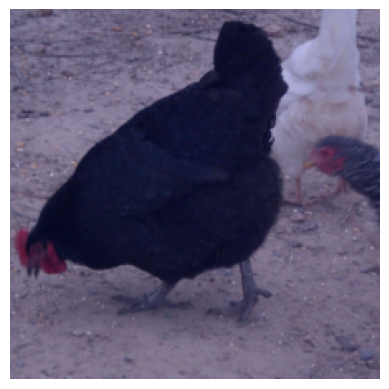

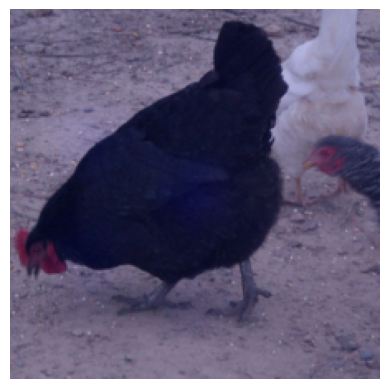

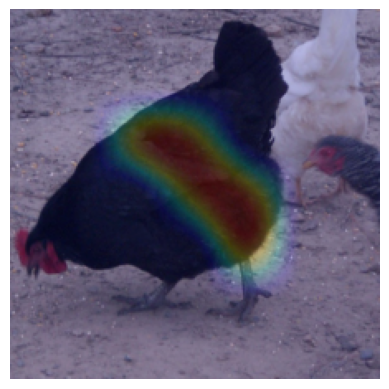

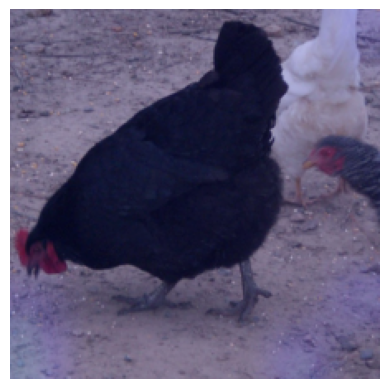

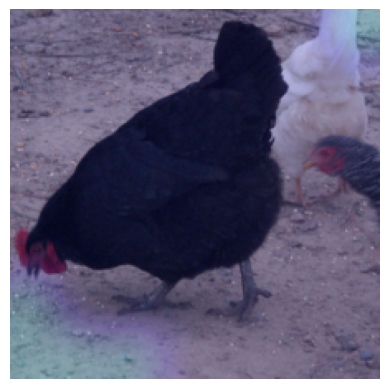

the shape of the features :  (14700, 2048)
calculating NMF ...................................
shape of U :  (14700, 5)
shape of V :  (5, 2048)


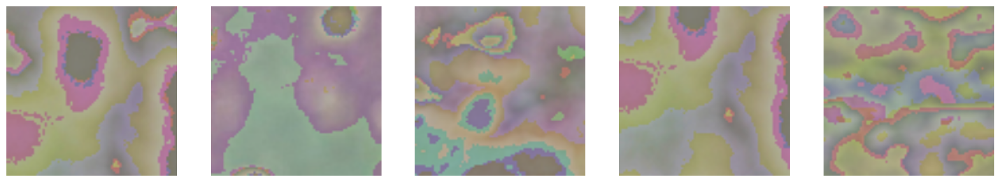

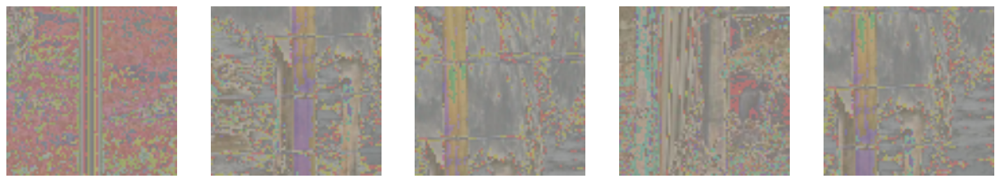

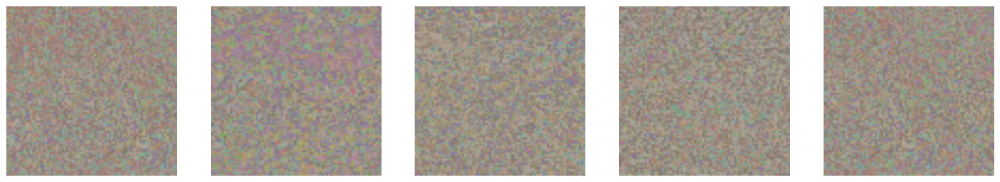

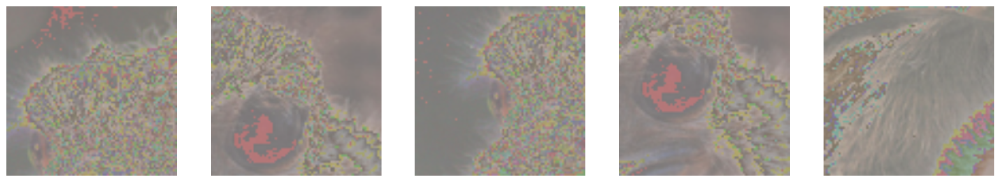

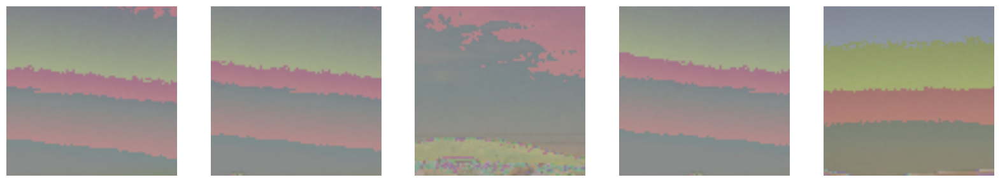

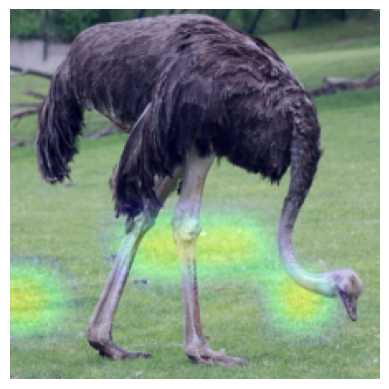

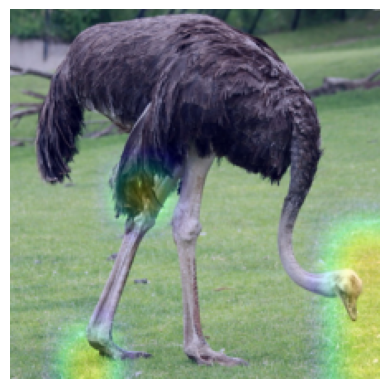

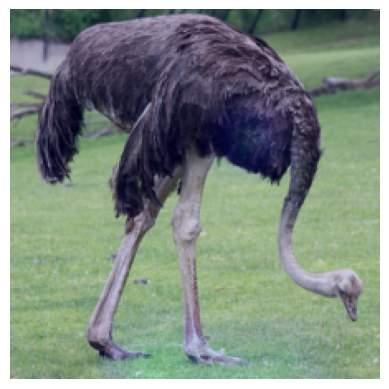

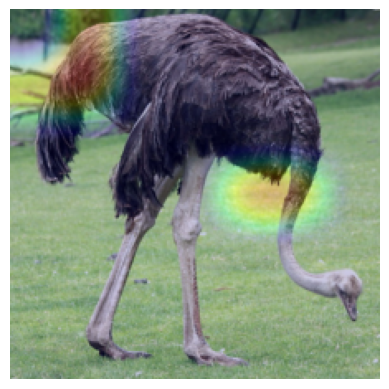

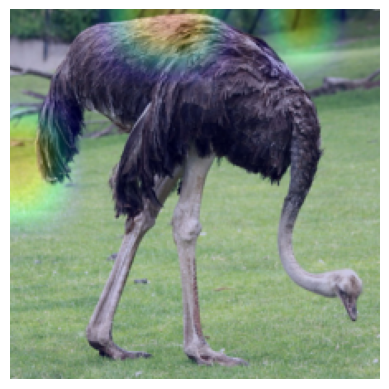

In [3]:
detector.fit(fit_dataset=ds_fit, model=model, feature_layers_id=["avgpool"])


In [ ]:

# Print information about the dataset and processing
print("Original dataset length:", len(ds_fit))
print("Number of classes processed:", len(detector.separate_classes))
print("Images per class:")
for label, images in detector.separated_class_images.items():
    print(f"Class {label}: {len(images)} original images.")

# Print the number of patches and total images after patch expansion
print("Images per class after converting to patches:")
for label, patches in detector.separated_class_images.items():
    print(f"Class {label}: {len(patches)} patches.")
    # Since each image is converted into 49 patches (7x7 grid)
    original_images_count = len(patches) // 49
    print(f"Converted from {original_images_count} original images.")

Original dataset length: 900
Number of classes processed: 3
Images per class:
Class 0: 14700 original images.
Class 1: 14700 original images.
Class 2: 14700 original images.
Images per class after converting to patches:
Class 0: 14700 patches.
Converted from 300 original images.
Class 1: 14700 patches.
Converted from 300 original images.
Class 2: 14700 patches.
Converted from 300 original images.
